In [1]:
#ngboost and modelling libraries
from ngboost import NGBClassifier
from ngboost.distns import Bernoulli
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import roc_curve, classification_report, roc_auc_score

#data manipulation libraries
import pandas as pd
import numpy as np

#data viz libraries
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

#ignore warnings
import warnings
warnings.filterwarnings('ignore')

## FUNCTIONS 

In [2]:
def correlation_heatmap(df):
    """
    Plot a correlation heatmap for the entire dataframe
    
    Args:
        - df (DataFrame object): dataframe to be illustrated
    """
    heatmap = go.Heatmap(
        z=df.corr(method='pearson').as_matrix(),
        x=df.columns,
        y=df.columns,
        colorbar=dict(title='Pearson Coefficient'),
        colorscale='Reds',
    )
    
    layout = go.Layout(title="Matriz de correlaciones")
    
    fig = go.Figure(data=[heatmap], layout=layout)
    iplot(fig)

In [3]:
def preprocess_df(df):
    """
    Preprocess df imputing certain columns such as MonthlyIncome and NumberOfDependencies
    
    Args:
        -df (DataFrame object): df to be computed
    """
    df['MonthlyIncome'].fillna(df['MonthlyIncome'].mean(),inplace=True)
    df['NumberOfDependents'].fillna(df['NumberOfDependents'].mode()[0], inplace=True)
    df.loc[df["age"] == 0, "age"] = df.age.median()
    df.loc[df["age"] >= 100, "age"] = df.age.median()
    df["MonthlyIncome"] = np.absolute(df["MonthlyIncome"])
    df.loc[(df["age"] >= 60), "MonthlyIncome"] = df.loc[(df["age"] >= 60)].MonthlyIncome.mean()

In [4]:
def plot_target_balance(target_value_counts):
    """
    Plot target balance
    
    Args:
        - target_value_counts(pd.Series object): Serie that contains counts of each instance of target variable.
    """
    data = [go.Bar(
                x=['target=0'],
                y=[target_value_counts[0]],
                  marker=dict(color='cornflowerblue'),name='target=0'),
            go.Bar(
                x=['target=1'],
                y=[target_value_counts[1]],
                  marker=dict(color='darksalmon'),name='target=1')
                 ]
    layout = dict(title = 'Proporción del target',
                  xaxis = dict(title = 'Target value'),
                  yaxis = dict(title = 'Count')
                  )
    fig = dict(data=data, layout=layout)
    iplot(fig)

In [ ]:
def plot_trace_line(df_target_zero, df_target_one, column_to_op, op_name):
    """
    Plot lines with 'age' column as x axis and custom column (to compute sum/avg).
    
    Args:
        - df_target_zero (DataFrame Object): rows of df that contain target = 0
        - df_target_ one (DataFrame Object): rows of df that contain target = 1
        - column_to_op (string): name of column to be computed
        - op_name (string): Operation to be computed. For example: "Sum" or "Avg" 
    """
    if op_name == "Sum":
        df_target_zero_op = df_target_zero.groupby("age").sum()
        df_target_one_op = df_target_one.groupby("age").sum()
    if op_name == "Avg":
        df_target_zero_op = df_target_zero.groupby("age").mean()
        df_target_one_op = df_target_one.groupby("age").mean()
    # Create and style traces
    trace0 = go.Scatter(
        x = df_target_zero_op.index,
        y = df_target_zero_op[column_to_op],
        name = 'TARGET=0',
        line = dict(
            color = 'rgb(167, 103, 4)',
            width = 4)
    )
    trace1 = go.Scatter(
        x = df_target_one_op.index,
        y = df_target_one_op[column_to_op],
        name = 'TARGET=1',
        line = dict(
            color = "rgb(32, 205, 119)",
            width = 4)
    )
    data = [trace0, trace1]

    # Edit the layout
    layout = dict(title = f"{op_name} of {column_to_op} according to the age",
                  xaxis = dict(title = 'Age'),
                  yaxis = dict(title = f"{op_name} of {column_to_op}"),
                  )

    fig = dict(data=data, layout=layout)
    iplot(fig)

In [5]:
def plot_feature_importances(features, clf):
    """
    Show feature importances plot.
    
    Args:
        - features (list of strings): list of name columns
        - clf (XGboost model): XGboost model that was trained
    """
    trace1 = go.Bar(
    y=features,
    x=clf.feature_importances_[0],
    marker=dict(color="cornflowerblue",
            opacity=1),orientation='h'
    )

    data = [trace1]
    layout = go.Layout(
        barmode='group', margin=go.layout.Margin(
            l=120,
            r=50,
            b=100,
            t=100,
            pad=4
        ),title = 'Feature importances',
                  xaxis = dict(title = 'Importance'),
                  yaxis = dict(title = 'Features')
                  )
    fig = dict(data=data, layout=layout)
    iplot(fig)


## READING DATAFRAME

In [6]:
cols = [
 'SeriousDlqin2yrs',
 'RevolvingUtilizationOfUnsecuredLines',
 'age',
 'NumberOfTime30-59DaysPastDueNotWorse',
 'DebtRatio',
 'MonthlyIncome',
 'NumberOfOpenCreditLinesAndLoans',
 'NumberOfTimes90DaysLate',
 'NumberRealEstateLoansOrLines',
 'NumberOfTime60-89DaysPastDueNotWorse',
 'NumberOfDependents']

In [7]:
df = pd.read_csv("./data/cs-training.csv", usecols =cols)

In [8]:
df.age.unique()

array([ 45,  40,  38,  30,  49,  74,  57,  39,  27,  51,  46,  76,  64,
        78,  53,  43,  25,  32,  58,  50,  69,  24,  28,  62,  42,  75,
        26,  52,  41,  81,  31,  68,  70,  73,  29,  55,  35,  72,  60,
        67,  36,  56,  37,  66,  83,  34,  44,  48,  61,  80,  47,  59,
        77,  63,  54,  33,  79,  65,  86,  92,  23,  87,  71,  22,  90,
        97,  84,  82,  91,  89,  85,  88,  21,  93,  96,  99,  94,  95,
       101,  98, 103, 102, 107, 105,   0, 109])

In [9]:
df.loc[df["age"] == 101, "age"]

7763      101
93813     101
116129    101
Name: age, dtype: int64

In [17]:
df.head()
#df_test.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.766127,45.0,2,0.802982,9120.0,13,0,6,0,2.0
1,0,0.957151,40.0,0,0.121876,2600.0,4,0,0,0,1.0
2,0,0.658180,38.0,1,0.085113,3042.0,2,1,0,0,0.0
3,0,0.233810,30.0,0,0.036050,3300.0,5,0,0,0,0.0
4,0,0.907239,49.0,1,0.024926,63588.0,7,0,1,0,0.0


In [11]:
print(df.isnull().sum())

SeriousDlqin2yrs                            0
RevolvingUtilizationOfUnsecuredLines        0
age                                         0
NumberOfTime30-59DaysPastDueNotWorse        0
DebtRatio                                   0
MonthlyIncome                           29731
NumberOfOpenCreditLinesAndLoans             0
NumberOfTimes90DaysLate                     0
NumberRealEstateLoansOrLines                0
NumberOfTime60-89DaysPastDueNotWorse        0
NumberOfDependents                       3924
dtype: int64


In [12]:
df.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,1.202690e+05,150000.000000,150000.000000,150000.000000,150000.000000,146076.000000
mean,0.066840,6.048438,52.295207,0.421033,353.005076,6.670221e+03,8.452760,0.265973,1.018240,0.240387,0.757222
std,0.249746,249.755371,14.771866,4.192781,2037.818523,1.438467e+04,5.145951,4.169304,1.129771,4.155179,1.115086
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.029867,41.000000,0.000000,0.175074,3.400000e+03,5.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.154181,52.000000,0.000000,0.366508,5.400000e+03,8.000000,0.000000,1.000000,0.000000,0.000000
75%,0.000000,0.559046,63.000000,0.000000,0.868254,8.249000e+03,11.000000,0.000000,2.000000,0.000000,1.000000
max,1.000000,50708.000000,109.000000,98.000000,329664.000000,3.008750e+06,58.000000,98.000000,54.000000,98.000000,20.000000


### duda con debtratio

In [44]:
sorted(df.DebtRatio.unique())
for e in sorted(df.DebtRatio.unique()):
    if e > 1:
        print(e)

1.000499875
1.0005274259999999
1.000666223
1.000874126
1.000898992
1.001086694
1.0011750879999999
1.001195522
1.001224365
1.0012494790000002
1.0013413
1.001370802
1.001465201
1.00149925
1.001525165
1.0015372790000001
1.001565558
1.00159936
1.001619579
1.00184604
1.001917546
1.001999
1.002181705
1.002281617
1.002320378
1.002437835
1.002497918
1.002499107
1.002514669
1.002612915
1.002695418
1.0027151559999998
1.002855103
1.002903039
1.002906977
1.002971089
1.002998501
1.003074558
1.0031419590000001
1.003172772
1.00329967
1.003536247
1.003576903
1.003634711
1.0037281820000001
1.0038114059999999
1.003827507
1.00394633
1.003997335
1.004054376
1.004144891
1.004188482
1.00428449
1.004367357
1.004373633
1.004422226
1.004498875
1.00479693
1.004800904
1.005026755
1.005247243
1.005451987
1.005555556
1.005577151
1.00559888
1.005621487
1.0056271559999999
1.0056647779999999
1.00569886
1.0057088490000001
1.0059982859999999
1.0060152820000001
1.006031666
1.0063974409999998
1.00660502
1.006666213
1.006

1.704893868
1.7049180330000002
1.7058541269999998
1.7061469269999998
1.707154742
1.707743547
1.709737134
1.709953012
1.7106529209999999
1.710723192
1.7107630790000001
1.711786756
1.7121439280000001
1.7126197419999998
1.712633452
1.7136027809999999
1.713861018
1.7140714819999998
1.715509854
1.715713715
1.7159389790000001
1.71685543
1.717501585
1.718056389
1.718912435
1.719101124
1.720913633
1.7209985319999999
1.720999405
1.721455458
1.7226154359999999
1.724078835
1.7241918669999998
1.724353256
1.724570057
1.724647194
1.725124378
1.7262479869999998
1.7268193859999998
1.728311317
1.729255169
1.729459499
1.7296683330000002
1.7298962390000001
1.73028216
1.730423192
1.73080481
1.732325695
1.7326336830000002
1.732909974
1.7334839069999999
1.7358916480000002
1.736318408
1.736499069
1.736870168
1.737267968
1.738491675
1.73855359
1.7387727119999998
1.739977933
1.740101221
1.7401623990000001
1.740753082
1.7408637869999999
1.741419527
1.742561983
1.743179546
1.7439149809999999
1.74450803
1.7452547

1519.0
1520.0
1521.0
1522.0
1523.0
1524.0
1525.0
1526.0
1527.0
1528.0
1529.0
1530.0
1531.0
1532.0
1533.0
1534.0
1535.0
1536.0
1537.0
1538.0
1539.0
1540.0
1541.0
1542.0
1543.0
1544.0
1545.0
1546.0
1547.0
1548.0
1549.0
1549.5
1550.0
1551.0
1552.0
1553.0
1554.0
1555.0
1556.0
1557.0
1558.0
1559.0
1560.0
1561.0
1562.0
1563.0
1564.0
1565.0
1566.0
1567.0
1567.5
1568.0
1569.0
1570.0
1571.0
1572.0
1573.0
1574.0
1575.0
1576.0
1577.0
1578.0
1579.0
1580.0
1581.0
1582.0
1583.0
1584.0
1585.0
1586.0
1587.0
1588.0
1589.0
1590.0
1591.0
1592.0
1593.0
1594.0
1595.0
1596.0
1597.0
1598.0
1599.0
1600.0
1601.0
1602.0
1603.0
1603.5
1604.0
1605.0
1606.0
1607.0
1608.0
1608.5
1609.0
1610.0
1611.0
1612.0
1613.0
1614.0
1615.0
1616.0
1617.0
1618.0
1619.0
1620.0
1621.0
1622.0
1623.0
1624.0
1625.0
1626.0
1627.0
1628.0
1629.0
1630.0
1631.0
1632.0
1632.5
1633.0
1634.0
1635.0
1635.5
1636.0
1637.0
1638.0
1639.0
1640.0
1641.0
1642.0
1643.0
1644.0
1645.0
1646.0
1647.0
1648.0
1649.0
1650.0
1651.0
1652.0
1653.0
1654.0
1655.0

5833.0
5835.0
5836.0
5837.0
5841.0
5843.0
5847.0
5848.0
5849.0
5850.0
5851.0
5852.0
5853.0
5855.0
5857.0
5858.0
5860.0
5863.0
5869.0
5870.0
5873.0
5875.0
5878.0
5885.0
5888.0
5889.0
5891.0
5896.0
5898.0
5901.0
5903.0
5905.0
5907.0
5908.0
5909.0
5919.0
5920.0
5921.0
5924.0
5932.0
5933.0
5935.0
5939.0
5941.0
5943.0
5944.0
5945.0
5949.0
5954.0
5955.0
5957.0
5965.0
5968.0
5969.0
5970.0
5971.0
5974.0
5979.0
5980.0
5981.0
5983.0
5984.0
5993.0
5994.0
5995.0
5998.0
6002.0
6003.0
6004.0
6006.0
6008.0
6009.0
6010.0
6012.0
6013.0
6015.0
6024.0
6025.0
6026.0
6031.0
6032.0
6039.0
6040.0
6046.0
6049.0
6055.0
6060.0
6063.0
6066.0
6067.0
6069.0
6071.0
6073.0
6074.0
6085.0
6091.0
6096.0
6097.0
6100.0
6101.0
6102.0
6103.0
6104.0
6105.0
6106.0
6109.0
6113.0
6114.0
6117.0
6131.0
6133.0
6135.0
6136.0
6137.0
6148.0
6152.0
6154.0
6156.0
6160.0
6161.0
6162.0
6163.0
6164.0
6166.0
6171.0
6173.0
6174.0
6178.0
6183.0
6185.0
6186.0
6188.0
6189.0
6191.0
6192.0
6194.0
6197.0
6211.0
6215.0
6217.0
6219.0
6220.0
6222.0

In [13]:
df.SeriousDlqin2yrs.value_counts()

0    139974
1     10026
Name: SeriousDlqin2yrs, dtype: int64

In [16]:
plot_target_balance(df.SeriousDlqin2yrs.value_counts())

In [22]:
df_target_zero = df[df.SeriousDlqin2yrs == 0]
df_target_one = df[df.SeriousDlqin2yrs == 1]

In [23]:
df.columns

Index(['SeriousDlqin2yrs', 'RevolvingUtilizationOfUnsecuredLines', 'age',
       'NumberOfTime30-59DaysPastDueNotWorse', 'DebtRatio', 'MonthlyIncome',
       'NumberOfOpenCreditLinesAndLoans', 'NumberOfTimes90DaysLate',
       'NumberRealEstateLoansOrLines', 'NumberOfTime60-89DaysPastDueNotWorse',
       'NumberOfDependents'],
      dtype='object')

In [37]:
df.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,1.500000e+05,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000
mean,0.066840,6.048438,52.291073,0.421033,353.005076,6.670221e+03,8.452760,0.265973,1.018240,0.240387,0.737413
std,0.249746,249.755371,14.763474,4.192781,2037.818523,1.114369e+04,5.145951,4.169304,1.129771,4.155179,1.107021
min,0.000000,0.000000,21.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.029867,41.000000,0.000000,0.175074,5.000000e+03,5.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.154181,52.000000,0.000000,0.366508,6.726662e+03,8.000000,0.000000,1.000000,0.000000,0.000000
75%,0.000000,0.559046,63.000000,0.000000,0.868254,6.726662e+03,11.000000,0.000000,2.000000,0.000000,1.000000
max,1.000000,50708.000000,99.000000,98.000000,329664.000000,3.008750e+06,58.000000,98.000000,54.000000,98.000000,20.000000


In [49]:
df['NumberOfTime30-59DaysPastDueNotWorse'].unique()

array([ 2,  0,  1,  3,  4,  5,  7, 10,  6, 98, 12,  8,  9, 96, 13, 11])

In [45]:
plot_trace_line(df_target_zero, df_target_one, 'RevolvingUtilizationOfUnsecuredLines', 'Avg')

In [46]:
plot_trace_line(df_target_zero, df_target_one, 'NumberOfTime30-59DaysPastDueNotWorse', 'Avg')

In [50]:
plot_trace_line(df_target_zero, df_target_one, 'DebtRatio', 'Avg')

In [51]:
plot_trace_line(df_target_zero, df_target_one, 'MonthlyIncome', 'Avg')

In [52]:
plot_trace_line(df_target_zero, df_target_one, 'NumberOfOpenCreditLinesAndLoans', 'Avg')

In [53]:
plot_trace_line(df_target_zero, df_target_one, 'NumberOfTimes90DaysLate', 'Avg')

In [54]:
plot_trace_line(df_target_zero, df_target_one, 'NumberRealEstateLoansOrLines', 'Avg')

In [55]:
plot_trace_line(df_target_zero, df_target_one, 'NumberOfTime60-89DaysPastDueNotWorse', 'Avg')

In [56]:
plot_trace_line(df_target_zero, df_target_one, 'NumberOfDependents', 'Avg')

In [87]:
textd = ['target=0' if target==0 else 'target=1' for target in df['SeriousDlqin2yrs']]

fig = go.Figure(data=go.Splom(
                  dimensions=[dict(label='RevUtilOfUnsecLines', values=df['RevolvingUtilizationOfUnsecuredLines']),
                              dict(label='age', values=df['age']),
                              dict(label='NTime30-59Days', values=df['NumberOfTime30-59DaysPastDueNotWorse']),
                              dict(label='DebtRatio', values=df['DebtRatio']),
                              dict(label='MonthlyIncome', values=df['MonthlyIncome']),
                              dict(label='NOpenCreditLinesLoans', values=df['NumberOfOpenCreditLinesAndLoans']),
                              dict(label='NTimes90DaysLate', values=df['NumberOfTimes90DaysLate']),
                              dict(label='NRealEstateLoansLines', values=df['NumberRealEstateLoansOrLines']),
                              dict(label='NTime60-89Days', values=df['NumberOfTime60-89DaysPastDueNotWorse']),
                              dict(label='NDepend', values=df['NumberOfDependents'])],
                  marker=dict(color=df['SeriousDlqin2yrs'],
                              size=5,
                              colorscale='Bluered',
                              line=dict(width=0.5,
                                        color='rgb(230,230,230)')),
                  text=textd, 
                  diagonal=dict(visible=False)))


fig.update_layout(
                  title={
                 'text': "Scatterplot Matrix of Dataset",
                 'x':0.5,
                 'xanchor': 'center',
                 'yanchor': 'top'},
                  dragmode='select',
                  width=1000,
                  height=1000,
                  hovermode='closest',
                 font=dict(
                 size=7,
                 color="#7f7f7f"))


fig.show()

## FEATURE ENGINEERING

In [15]:
preprocess_df(df)

In [58]:
df.age.unique()

array([45., 40., 38., 30., 49., 74., 57., 39., 27., 51., 46., 76., 64.,
       78., 53., 43., 25., 32., 58., 50., 69., 24., 28., 62., 42., 75.,
       26., 52., 41., 81., 31., 68., 70., 73., 29., 55., 35., 72., 60.,
       67., 36., 56., 37., 66., 83., 34., 44., 48., 61., 80., 47., 59.,
       77., 63., 54., 33., 79., 65., 86., 92., 23., 87., 71., 22., 90.,
       97., 84., 82., 91., 89., 85., 88., 21., 93., 96., 99., 94., 95.,
       98.])

# EXPLORATORY DATA ANALYSIS

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 11 columns):
SeriousDlqin2yrs                        150000 non-null int64
RevolvingUtilizationOfUnsecuredLines    150000 non-null float64
age                                     150000 non-null int64
NumberOfTime30-59DaysPastDueNotWorse    150000 non-null int64
DebtRatio                               150000 non-null float64
MonthlyIncome                           150000 non-null float64
NumberOfOpenCreditLinesAndLoans         150000 non-null int64
NumberOfTimes90DaysLate                 150000 non-null int64
NumberRealEstateLoansOrLines            150000 non-null int64
NumberOfTime60-89DaysPastDueNotWorse    150000 non-null int64
NumberOfDependents                      150000 non-null float64
dtypes: float64(4), int64(7)
memory usage: 12.6 MB


In [13]:
print(df.isnull().sum())

SeriousDlqin2yrs                        0
RevolvingUtilizationOfUnsecuredLines    0
age                                     0
NumberOfTime30-59DaysPastDueNotWorse    0
DebtRatio                               0
MonthlyIncome                           0
NumberOfOpenCreditLinesAndLoans         0
NumberOfTimes90DaysLate                 0
NumberRealEstateLoansOrLines            0
NumberOfTime60-89DaysPastDueNotWorse    0
NumberOfDependents                      0
dtype: int64


In [14]:
df.corr()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
SeriousDlqin2yrs,1.000000,-0.001802,-0.115386,0.125587,-0.007602,-0.018002,-0.029669,0.117175,-0.007038,0.102261,0.046869
RevolvingUtilizationOfUnsecuredLines,-0.001802,1.000000,-0.005898,-0.001314,0.003961,0.006565,-0.011281,-0.001061,0.006235,-0.001048,0.001193
age,-0.115386,-0.005898,1.000000,-0.062995,0.024188,0.032984,0.147705,-0.061005,0.033150,-0.057159,-0.215693
NumberOfTime30-59DaysPastDueNotWorse,0.125587,-0.001314,-0.062995,1.000000,-0.006542,-0.007636,-0.055312,0.983603,-0.030565,0.987005,-0.004590
DebtRatio,-0.007602,0.003961,0.024188,-0.006542,1.000000,-0.005355,0.049565,-0.008320,0.120046,-0.007533,-0.044476
MonthlyIncome,-0.018002,0.006565,0.032984,-0.007636,-0.005355,1.000000,0.082319,-0.009484,0.113823,-0.008259,0.058192
NumberOfOpenCreditLinesAndLoans,-0.029669,-0.011281,0.147705,-0.055312,0.049565,0.082319,1.000000,-0.079984,0.433959,-0.071077,0.074026
NumberOfTimes90DaysLate,0.117175,-0.001061,-0.061005,0.983603,-0.008320,-0.009484,-0.079984,1.000000,-0.045205,0.992796,-0.011962
NumberRealEstateLoansOrLines,-0.007038,0.006235,0.033150,-0.030565,0.120046,0.113823,0.433959,-0.045205,1.000000,-0.039722,0.129399
NumberOfTime60-89DaysPastDueNotWorse,0.102261,-0.001048,-0.057159,0.987005,-0.007533,-0.008259,-0.071077,0.992796,-0.039722,1.000000,-0.012678


In [15]:
cor=df.corr()
correlation_heatmap(cor)

## NGBOOST MODEL

In [16]:
X = df.drop(columns=['SeriousDlqin2yrs']).values
y = df.SeriousDlqin2yrs.values

In [17]:
len(X)

150000

In [18]:
len(y)

150000

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [20]:
ngb_clf = NGBClassifier(Dist=Bernoulli)
ngb_clf.fit(X_train, y_train)
preds = ngb_clf.pred_dist(X_test)
#print("ROC:", roc_auc_score(y_test, preds.prob))

[iter 0] loss=0.2468 val_loss=0.0000 scale=0.5000 norm=1.0000
[iter 100] loss=0.1918 val_loss=0.0000 scale=2.0000 norm=3.3921
[iter 200] loss=0.1839 val_loss=0.0000 scale=1.0000 norm=1.7944
[iter 300] loss=0.1816 val_loss=0.0000 scale=0.5000 norm=0.9285
[iter 400] loss=0.1804 val_loss=0.0000 scale=0.5000 norm=0.9458


In [21]:
ngb_clf

NGBClassifier(Base=DecisionTreeRegressor(ccp_alpha=0.0,
                                         criterion='friedman_mse', max_depth=3,
                                         max_features=None, max_leaf_nodes=None,
                                         min_impurity_decrease=0.0,
                                         min_impurity_split=None,
                                         min_samples_leaf=1,
                                         min_samples_split=2,
                                         min_weight_fraction_leaf=0.0,
                                         presort='deprecated',
                                         random_state=None, splitter='best'),
              Dist=<class 'ngboost.distns.categorical.k_categorical.<locals>.Categorical'>,
              Score=<class 'ngboost.scores.LogScore'>, learning_rate=0.01,
              minibatch_frac=1.0, n_estimators=500, natural_gradient=True,
              random_state=RandomState(MT19937) at 0x7F8D69FF9E20, tol=0

In [22]:
# n_estimators
# learning_rate
# max_depth

In [23]:
plot_feature_importances(cols[1:], ngb_clf)

In [32]:
visualize_roc_curve(ngb_clf, X_test, y_test)

              precision    recall  f1-score   support

           0       0.94      0.99      0.97     46247
           1       0.62      0.14      0.23      3253

    accuracy                           0.94     49500
   macro avg       0.78      0.57      0.60     49500
weighted avg       0.92      0.94      0.92     49500



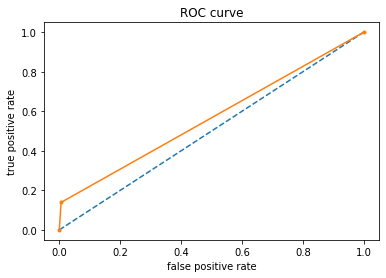

In [35]:
def plot_roc(y_test,prob):
    fpr, tpr, thresholds = roc_curve(y_test, prob)
    # plot no skill
    plt.plot([0, 1], [0, 1], linestyle='--')
    # plot the roc curve for the model
    plt.plot(fpr, tpr, marker='.')
    plt.title("ROC curve")
    plt.xlabel('false positive rate')
    plt.ylabel('true positive rate')
    # show the plot
    plt.show()
proba =  ngb_clf.predict(X_test)    
plot_roc(y_test,proba)

In [38]:
visualize_roc_curve(ngb_clf, X_test, y_test)

              precision    recall  f1-score   support

           0       0.94      0.99      0.97     46247
           1       0.62      0.14      0.23      3253

    accuracy                           0.94     49500
   macro avg       0.78      0.57      0.60     49500
weighted avg       0.92      0.94      0.92     49500



In [36]:
def visualize_roc_curve(model, X_test, y_test):
    y_pred = model.predict(X_test)
    
    fpr, tpr, _ = roc_curve(y_test, y_pred)
    
    print(classification_report(y_test, y_pred))
    
    
    
    trace0 = go.Scatter(
    x = fpr,
    y = tpr,
    name = 'Predictive Model',
    line = dict(
        color = 'blue',
        width = 2)
    )
    trace1 = go.Scatter(
        x0 = 0,
        x = [0,1],
        y0 = 0,
        y = [0,1],
        name = "Random Chance",
        line = dict(
            color = "grey",
            width = 2)
    )
 
    data = [trace0, trace1]

    # Edit the layout
    layout = dict(title = 'ROC curve',
                  xaxis = dict(title = 'FPR'),
                  yaxis = dict(title = 'TPR'),
                  )

    fig = dict(data=data, layout=layout)

    iplot(fig)


In [27]:
ngb_clf.feature_importances_

array([[3.69645936e-01, 1.59058256e-01, 1.01928653e-01, 3.25576936e-02,
        5.57906951e-02, 9.88551278e-02, 8.00425269e-02, 4.41494293e-02,
        5.77417991e-02, 2.29883171e-04]])

In [54]:
ngb_clf.natural_gradient

True

In [199]:
ngb.get_params

<bound method BaseEstimator.get_params of NGBRegressor(Base=DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                                        max_features=None, max_leaf_nodes=None,
                                        min_impurity_decrease=0.0,
                                        min_impurity_split=None,
                                        min_samples_leaf=1, min_samples_split=2,
                                        min_weight_fraction_leaf=0.0,
                                        presort=False, random_state=None,
                                        splitter='best'),
             Dist=<class 'ngboost.distns.normal.Normal'>,
             Score=<class 'ngboost.scores.LogScore'>, learning_rate=0.01,
             minibatch_frac=1.0, n_estimators=50, natural_gradient=True,
             random_state=RandomState(MT19937) at 0x7F29D40D8E20, tol=0.0001,
             verbose=True, verbose_eval=10)>

In [200]:
ngb.base_models

[[DecisionTreeRegressor(criterion='friedman_mse', max_depth=3, max_features=None,
                        max_leaf_nodes=None, min_impurity_decrease=0.0,
                        min_impurity_split=None, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        presort=False, random_state=None, splitter='best'),
  DecisionTreeRegressor(criterion='friedman_mse', max_depth=3, max_features=None,
                        max_leaf_nodes=None, min_impurity_decrease=0.0,
                        min_impurity_split=None, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        presort=False, random_state=None, splitter='best')],
 [DecisionTreeRegressor(criterion='friedman_mse', max_depth=3, max_features=None,
                        max_leaf_nodes=None, min_impurity_decrease=0.0,
                        min_impurity_split=None, min_samples_leaf=1,
                        min_

In [204]:
ngb.pred_param

<bound method NGBoost.pred_param of NGBRegressor(Base=DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                                        max_features=None, max_leaf_nodes=None,
                                        min_impurity_decrease=0.0,
                                        min_impurity_split=None,
                                        min_samples_leaf=1, min_samples_split=2,
                                        min_weight_fraction_leaf=0.0,
                                        presort=False, random_state=None,
                                        splitter='best'),
             Dist=<class 'ngboost.distns.normal.Normal'>,
             Score=<class 'ngboost.scores.LogScore'>, learning_rate=0.01,
             minibatch_frac=1.0, n_estimators=50, natural_gradient=True,
             random_state=RandomState(MT19937) at 0x7F29D40D8E20, tol=0.0001,
             verbose=True, verbose_eval=10)>

In [ ]:
ngb_clf.